In [1]:
%%bash
ls /mnt/storage/beesbook-data-clean/pipeline_data/repo_season_2016_fixed/2016/07/19/12/20/Cam_0_2016-07-19T12:37:31.470185Z--2016-07-19T12:38:13.327577Z.bbb

/mnt/storage/beesbook-data-clean/pipeline_data/repo_season_2016_fixed/2016/07/19/12/20/Cam_0_2016-07-19T12:37:31.470185Z--2016-07-19T12:38:13.327577Z.bbb


In [7]:
%run prep_training_data.py


/usr/local/lib/python3.5/dist-packages/matplotlib/__init__.py:913: UserWarning: axes.color_cycle is deprecated and replaced with axes.prop_cycle; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))
100%|██████████| 1487/1487 [00:00<00:00, 2012.56it/s]


Ground truth events loaded: 1487
Unique frame ids: 12677


12677it [00:00, 356944.67it/s]
  2%|▏         | 35/1487 [00:00<00:12, 112.64it/s]/usr/local/lib/python3.5/dist-packages/pandas/core/indexing.py:179: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
100%|██████████| 1487/1487 [00:19<00:00, 74.44it/s]


Index(['distance', 'trophallaxis', 'relrot_max', 'relrot_min', 'relrot_max_0',
       'relrot_max_1', 'relrot_max_2', 'relrot_min_0', 'relrot_min_1',
       'relrot_min_2', 'distance_0', 'distance_1', 'distance_2'],
      dtype='object')

In [8]:
#display(event_df.columns)
#display(len(event_df[event_df.trophallaxis == False]))
#display(len(event_df[event_df.trophallaxis == True]))
#display(len(gt_data))


verified = gt_data[gt_data.trophallaxis_observed == 'y']
display(verified.head())

durations = verified['trophallaxis_end_frame_nr'] - verified['trophallaxis_start_frame_nr'] + 1
print('durations:')
display(durations.describe())


,video_filename,track_id_combination,bee_a_detection_ids,bee_b_detection_ids,timestamps,frame_ids,cam_id,human_decidable_interaction,trophallaxis_observed,bee_a_is_donor,trophallaxis_start_frame_nr,trophallaxis_end_frame_nr,comments
event_id,,,,,,,,,,,,,
b68648cd-15d1-4d49-8bc1-4ae03ce1447e,b68648cd-15d1-4d49-8bc1-4ae03ce1447e.mp4,"('83010dae-337b-404e-84db-684707d81ff0', 'b6f1...","['f10874633732059940389d51c0', 'f1601936990086...","['f10874633732059940389d47c0', 'f1601936990086...","[1468932528.173565, 1468932528.505878, 1468932...","['10874633732059940389', '16019369900861471006...",0,y,y,y,5.0,31.0,NaN
87e2793e-5211-4b9d-acb9-5b3bf1192098,87e2793e-5211-4b9d-acb9-5b3bf1192098.mp4,"('fceb43b0-67bc-45eb-af0b-1820adbd8bf8', '3af1...","['f11407271298649801755d41c0', 'f1332459282309...","['f11407271298649801755d37c0', 'f1332459282309...","[1468932582.98768, 1468932584.317448, 14689325...","['11407271298649801755', '13324592823090786243...",0,y,y,y,12.0,18.0,maybe good example for angles
49c8d889-ff03-4600-b332-65ebd60d638b,49c8d889-ff03-4600-b332-65ebd60d638b.mp4,"('c49c4adc-3a9b-42f9-a827-7cd276c61195', 'a2d8...","['f14851388031793581091d108c0', 'f157597929427...","['f14851388031793581091d102c0', 'f157597929427...","[1468935259.571861, 1468935259.9042, 146893526...","['14851388031793581091', '15759792942757794767...",0,y,y,y,14.0,22.0,NaN
57555c7b-7cf2-4577-8318-8c0b3f414a24,57555c7b-7cf2-4577-8318-8c0b3f414a24.mp4,"('499b4252-0e96-4946-9774-9ff864850677', '9a0c...","['f15936233346181510807d60c0', 'f1381038275736...","['f15936233346181510807d68c0', 'f1381038275736...","[1468933458.018548, 1468933458.352018, 1468933...","['15936233346181510807', '13810382757364159583...",0,y,y,n,5.0,8.0,NaN
cc893a2d-fe1b-4740-8ef1-7c8c98994e65,cc893a2d-fe1b-4740-8ef1-7c8c98994e65.mp4,"('c4fe4ccd-0e49-4e8a-ab43-b588a6262bdc', '434d...","['f15507827484650630366d60c0', 'f9508854906973...","['f15507827484650630366d64c0', 'f9508854906973...","[1468935396.773145, 1468935397.105495, 1468935...","['15507827484650630366', '9508854906973912957'...",0,y,y,y,15.0,19.0,B mehrmals kurz Rüssel rausgestreckt


durations:


count    86.000000
mean     14.430233
std      19.690273
min       1.000000
25%       4.000000
50%       7.500000
75%      16.000000
max      95.000000
dtype: float64

In [9]:
for event in tqdm(gt_events):
    event.df["trophallaxis_observed"] = event.trophallaxis_observed
    
verified_events = list(filter(lambda x: x.trophallaxis_observed == True, gt_events))

100%|██████████| 1487/1487 [00:00<00:00, 1691.88it/s]


In [ ]:
# def plot_images():
#     num_images = int(event.end_frame_idx - event.begin_frame_idx)
#     num_columns = 4
#     plt.rcParams["figure.figsize"] = [16,16]
#     f, axarr = plt.subplots(math.ceil(num_images/num_columns), num_columns, sharex=True, sharey=True)
#     i = 0
#     for frame_index in tqdm(range(int(event.begin_frame_idx), int(event.end_frame_idx))):
#         fp = get_frame_plotter(event=event, frame_id=frame_ids[frame_index], 
#                                frame_index=frame_index)
#         fp.get_image()
#         frames.append(fp)
#         axarr[math.floor(i/num_columns), i % num_columns].imshow(fp)
#         i += 1

#     plt.tight_layout()
#     plt.show()

In [1]:
%run rotate.py

NameError: name 'math' is not defined

In [37]:
display(verified_events[8].df)


first_bee_rotation(event=verified_events[8],frame_index=0)

,x1,y1,orient1,timestamp1,x2,y2,orient2,timestamp2,distance,trophallaxis,...,relrot_max_0,relrot_max_1,relrot_max_2,relrot_min_0,relrot_min_1,relrot_min_2,distance_0,distance_1,distance_2,trophallaxis_observed
0,2850,2100,-0.829630,1.468932e+09,2851,1924,1.760235,1.468932e+09,176.002841,False,...,0.491582,0.494531,0.492236,0.370753,0.417953,0.443065,88.001385,82.278385,82.373251,True
1,2862,2075,-1.103640,1.468932e+09,2864,1925,1.594725,1.468932e+09,150.013333,False,...,0.991553,0.699279,0.591170,0.820141,0.608056,0.537970,163.007866,115.700481,99.126765,True
2,2862,2088,-1.146461,1.468932e+09,2851,1925,1.355814,1.468932e+09,163.370744,True,...,0.994535,0.853663,0.680722,0.890150,0.765159,0.626018,156.692072,141.268885,114.447666,True
3,2862,2087,-1.339879,1.468932e+09,2851,1925,1.285186,1.468932e+09,162.373027,True,...,0.982750,0.940200,0.753537,0.918619,0.867907,0.699880,162.871884,156.536968,127.112996,True
4,2862,2087,-1.329045,1.468932e+09,2851,1913,1.339461,1.468932e+09,174.347354,True,...,0.981130,0.975137,0.803579,0.954798,0.922592,0.753159,168.360175,163.950822,136.093390,True
5,2850,2087,-1.401095,1.468932e+09,2851,1925,1.277911,1.468932e+09,162.003086,False,...,0.986273,0.984165,0.826743,0.954748,0.946862,0.781129,168.175220,167.083123,140.655424,True
6,2850,2087,-1.433832,1.468932e+09,2851,1913,1.385568,1.468932e+09,174.002874,False,...,0.989031,0.980712,0.821207,0.968717,0.951756,0.781248,168.002997,167.699506,140.424115,True
7,2850,2087,-1.406200,1.468932e+09,2864,1913,1.390740,1.468932e+09,174.562310,False,...,0.993926,0.960042,0.787538,0.974061,0.934221,0.753441,174.282561,165.118395,135.412155,True
8,2837,2087,-1.525775,1.468932e+09,2864,1925,1.473547,1.468932e+09,164.234588,False,...,0.994621,0.904026,0.728618,0.966036,0.879090,0.700124,169.398426,156.720143,126.021557,True
9,2824,2100,-1.706730,1.468932e+09,2877,1962,1.379071,1.468932e+09,147.827602,False,...,0.934558,0.793053,0.649384,0.906934,0.769451,0.625979,156.031117,139.286801,113.015934,True


-0.829630494118


In [121]:
%%bash
pip3 install --user --upgrade --no-deps git+https://github.com/BioroboticsLab/beesbook_backend.git
#cat /usr/local/lib/python3.5/dist-packages/bb_backend/api.py

  Cloning https://github.com/BioroboticsLab/beesbook_backend.git to /tmp/pip-hni0nz31-build
  Running setup.py install for bb-backend: started
    Running setup.py install for bb-backend: finished with status 'done'


In [1]:
import bb_backend.api
from bb_backend.api import FramePlotter, VideoPlotter

frame = FramePlotter(frame_id=12072040577717273521, scale=1.0, crop_coordinates=(2686.0, 1568.0, 2813.0, 1695.0))
video = VideoPlotter(frames=[frame], n_frames_before_after=5, crop_coordinates=(2686.0, 1568.0, 2813.0, 1695.0))
buf = video.get_video()

In [10]:
gt_data.head()

,video_filename,track_id_combination,bee_a_detection_ids,bee_b_detection_ids,timestamps,frame_ids,cam_id,human_decidable_interaction,trophallaxis_observed,bee_a_is_donor,trophallaxis_start_frame_nr,trophallaxis_end_frame_nr,comments
event_id,,,,,,,,,,,,,
369617d4-7e4e-421e-8997-ddc47be2b5dc,369617d4-7e4e-421e-8997-ddc47be2b5dc.mp4,"('917fd158-0179-4e32-a8df-c4bfdf63fcae', '773d...","['f13087761212251145081d67c0', 'f1114189629628...","['f13087761212251145081d71c0', 'f1114189629628...","[1468935321.36231, 1468935321.694703, 14689353...","['13087761212251145081', '11141896296285122758...",0,y,n,NaN,NaN,NaN,NaN
29671996-d4bb-4e97-9328-4c71deb22ed5,29671996-d4bb-4e97-9328-4c71deb22ed5.mp4,"('917fd158-0179-4e32-a8df-c4bfdf63fcae', '4a39...","['f13281992008948746759d50c0', 'f1223603818537...","['f13281992008948746759d49c0', 'f1223603818537...","[1468935380.494952, 1468935380.827265, 1468935...","['13281992008948746759', '12236038185373356480...",0,y,n,NaN,NaN,NaN,NaN
ab8d0df0-3710-49ef-9cef-110f20a9ada4,ab8d0df0-3710-49ef-9cef-110f20a9ada4.mp4,"('917fd158-0179-4e32-a8df-c4bfdf63fcae', '4a39...","['f9500717914954886337d54c0', 'f13108390886957...","['f9500717914954886337d51c0', 'f13108390886957...","[1468935387.803612, 1468935388.13585, 14689353...","['9500717914954886337', '13108390886957492711'...",0,y,n,NaN,NaN,NaN,NaN
c53ccdde-db9c-4916-b09e-a4fe295dccf4,c53ccdde-db9c-4916-b09e-a4fe295dccf4.mp4,"('917fd158-0179-4e32-a8df-c4bfdf63fcae', '4a39...","['f10654328286109510462d53c0', 'f1180117045686...","['f10654328286109510462d55c0', 'f1180117045686...","[1468935408.068431, 1468935408.400211, 1468935...","['10654328286109510462', '11801170456866616045...",0,y,n,NaN,NaN,NaN,NaN
bda8ca28-c228-4c92-8c1c-df9ec846abed,bda8ca28-c228-4c92-8c1c-df9ec846abed.mp4,"('1f63075b-d6fc-43a0-9069-d15a9faeace2', '161b...","['f15753658694972060458d114c0', 'f150832719032...","['f15753658694972060458d111c0', 'f150832719032...","[1468934150.003914, 1468934150.336103, 1468934...","['15753658694972060458', '15083271903279094152...",0,y,n,NaN,NaN,NaN,NaN


In [36]:
frame_fc_map.head()

,frame_id,fc_id,fc_path,video_name
0,9239540679082842691,11492971883696513301,/mnt/storage/beesbook-data-clean/pipeline_data...,Cam_0_2016-07-19T12:37:31.470185Z--2016-07-19T...
1,9320261060217408709,11492971883696513301,/mnt/storage/beesbook-data-clean/pipeline_data...,Cam_0_2016-07-19T12:37:31.470185Z--2016-07-19T...
2,9612967736190922804,11492971883696513301,/mnt/storage/beesbook-data-clean/pipeline_data...,Cam_0_2016-07-19T12:37:31.470185Z--2016-07-19T...
3,9641118447709690012,11492971883696513301,/mnt/storage/beesbook-data-clean/pipeline_data...,Cam_0_2016-07-19T12:37:31.470185Z--2016-07-19T...
4,10108215446386292306,11492971883696513301,/mnt/storage/beesbook-data-clean/pipeline_data...,Cam_0_2016-07-19T12:37:31.470185Z--2016-07-19T...


## How many different features do we actually have? Ask PCA.

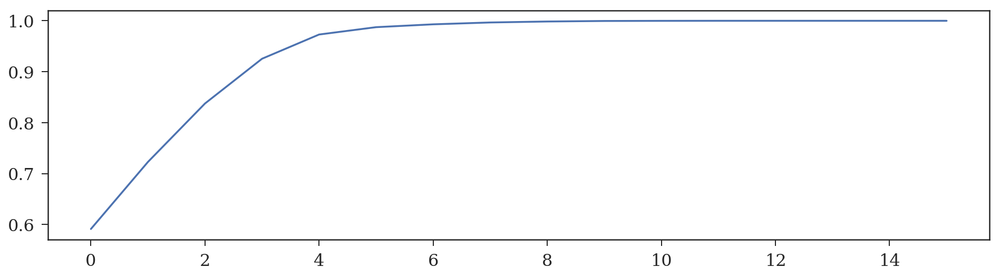

In [220]:
pca = sklearn.decomposition.PCA()
transformer = make_pipeline(sklearn.preprocessing.StandardScaler(), pca)
fX_ = transformer.fit_transform(fX)
fig, ax = plt.subplots(1, 1, figsize=(16, 4))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.show()

## Figure out a baseline: try to predict trophallaxis from the features.

In [221]:
scoring = "f1"
model = sklearn.ensemble.RandomForestClassifier()
acc = sklearn.model_selection.cross_val_score(model, fX_, y=fY, scoring=scoring)
print("{:20s}\t{}:\t{:3.2%}".format(str(model).split("(")[0], scoring, np.mean(acc)))

model = sklearn.linear_model.LogisticRegression()
acc = sklearn.model_selection.cross_val_score(model, fX_, y=fY, scoring=scoring)
print("{:20s}\t{}:\t{:3.2%}".format(str(model).split("(")[0], scoring, np.mean(acc)))

model = sklearn.dummy.DummyClassifier()
acc = sklearn.model_selection.cross_val_score(model, fX_, y=fY, scoring=scoring)
print("{:20s}\t{}:\t{:3.2%}".format(str(model).split("(")[0], scoring, np.mean(acc)))

RandomForestClassifier	f1:	48.14%
LogisticRegression  	f1:	28.32%
DummyClassifier     	f1:	5.32%


## Visualize the features.

In [222]:
sns.pairplot(data=feature_df, hue="trophallaxis", size=4, vars=[s for s in feature_df.columns if s !="trophallaxis"])

## Distribution of filter-parameters of trophallaxis and others.

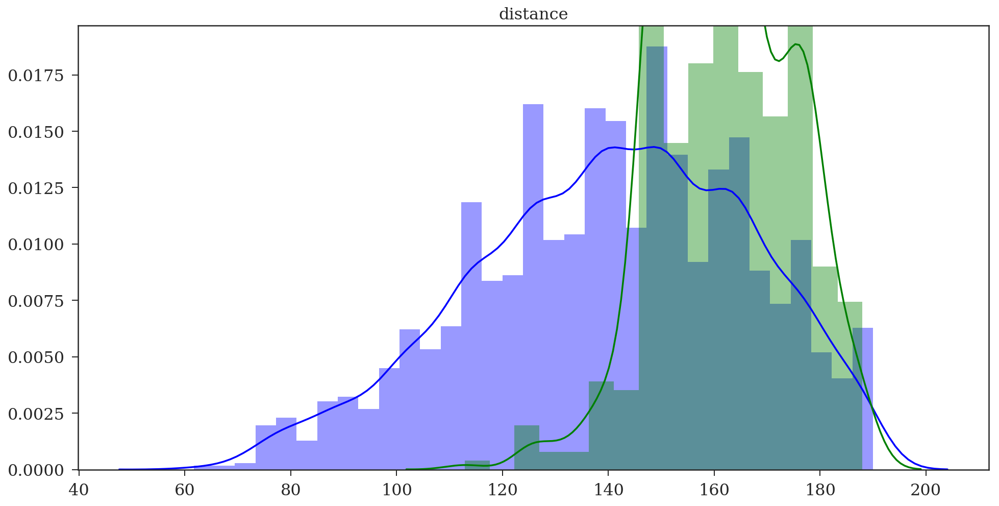

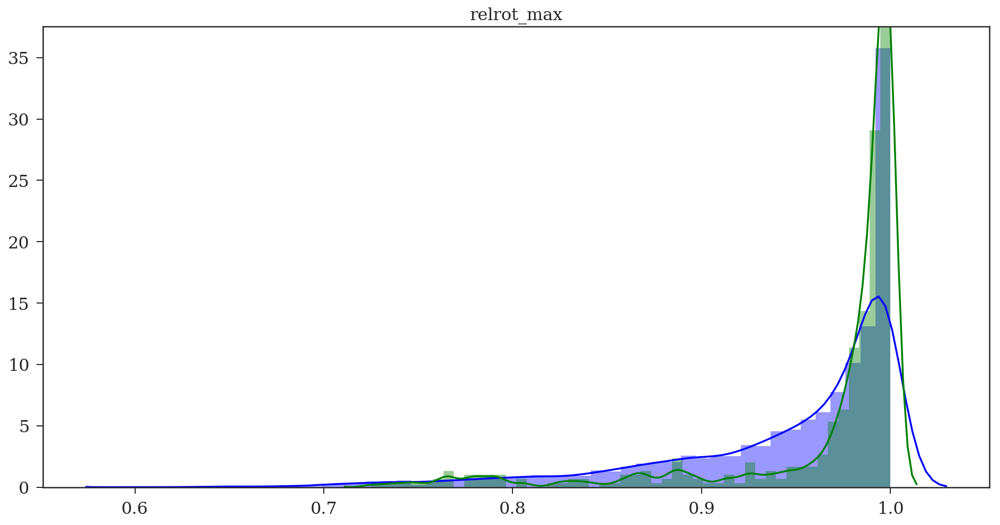

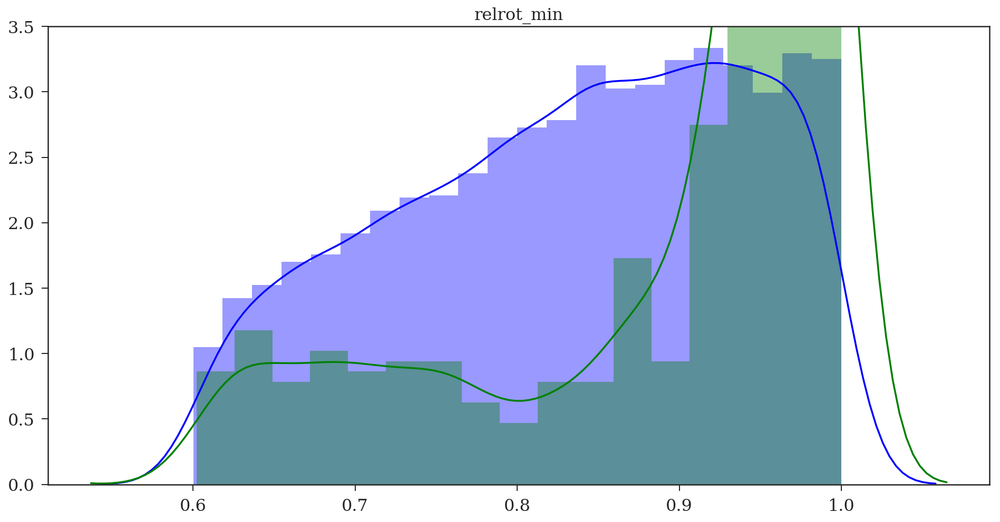

In [223]:
for feature in ("distance", "relrot_max", "relrot_min"):
    fig, ax = plt.subplots(1, 1, figsize=(16, 8))
    sns.distplot(event_df[event_df.trophallaxis == False][feature].values, ax=ax, color="blue")
    sns.distplot(event_df[event_df.trophallaxis == True][feature].values, ax=ax, color="green")
    plt.title(feature)
    plt.show()